# Note all charts appear in notebook , but all appear in html

In [1]:
import dask
from pprint import pprint
import dask.dataframe as dd
from dask.diagnostics import ProgressBar
from dask.multiprocessing import get
import pandas as pd                    
import numpy as np
import plotly.express as px
from statsmodels.graphics.tsaplots import plot_pacf,plot_acf
from pandas.plotting import autocorrelation_plot
import matplotlib.pyplot as plt
from plotly.subplots import make_subplots
import plotly.graph_objects as go
import seaborn as sns
from sklearn.model_selection import train_test_split
from statsmodels.tsa.arima. model import ARIMA
from statsmodels.tsa.stattools import adfuller
from sklearn.metrics import mean_squared_error
import numpy as np
from prophet import Prophet
from sklearn.model_selection import ParameterGrid
import itertools
import warnings
warnings.filterwarnings('ignore')

C:\Users\ASUS\AppData\Roaming\Python\Python311\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


# 1

# 1.a

In [2]:
data = dd.read_parquet('nyc_taxi_alt')

In [3]:
def build_info_ddf(ddf):
    info_ddf = dd.from_pandas(pd.DataFrame(ddf.dtypes), npartitions=1)
    info_ddf['total_observations'] = ddf.index.size
    info_ddf['missing_val'] = ddf.isnull().sum()
    info_ddf['missing_val_ratio'] = (info_ddf['missing_val'] / ddf.index.size * 100).round().astype(int)
    info_ddf = info_ddf.rename(columns = {0:'data_type'})
    return info_ddf

In [4]:
with ProgressBar():
    info = build_info_ddf(data).compute()
info

[########################################] | 100% Completed | 103.81 s


,data_type,total_observations,missing_val,missing_val_ratio
DOLocationID,int64,179311700,0,0
PULocationID,int64,179311700,0,0
RatecodeID,float64,179311700,3872186,2
VendorID,int64,179311700,0,0
airport_fee,object,179311700,0,0
congestion_surcharge,float64,179311700,8660504,5
extra,float64,179311700,0,0
fare_amount,float64,179311700,0,0
improvement_surcharge,float64,179311700,0,0
mta_tax,float64,179311700,0,0


In [119]:
with ProgressBar():
    des_data = data.describe().compute()
des_data.style.format(thousands=',', precision=2)

[########################################] | 100% Completed | 139.28 s


,VendorID,passenger_count,trip_distance,RatecodeID,PULocationID,DOLocationID,payment_type,fare_amount,extra,mta_tax,tip_amount,tolls_amount,improvement_surcharge,total_amount,congestion_surcharge
count,"179,311,700.00","175,439,514.00","179,311,700.00","175,439,514.00","179,311,700.00","179,311,700.00","179,311,700.00","179,311,700.00","179,311,700.00","179,311,700.00","179,311,700.00","179,311,700.00","179,311,700.00","179,311,700.00","170,651,196.00"
mean,1.67,1.49,4.41,1.14,163.79,161.78,1.35,12.62,1.06,0.50,3.32,0.41,0.30,19.70,2.24
std,0.47,1.12,421.92,2.89,65.99,70.44,0.72,"10,501.85",37.36,37.34,"10,500.32",1.85,0.07,198.63,0.79
min,1.00,0.00,"-37,264.53",1.00,1.00,1.00,1.00,"-133,391,414.00",-60.00,-0.55,-493.22,-99.99,-1.00,"-2,567.80",-2.50
25%,2.00,1.00,1.20,1.00,132.00,116.00,1.00,7.90,0.00,0.50,1.00,0.00,0.30,12.36,2.50
50%,2.00,1.00,2.10,1.00,162.00,163.00,1.00,12.00,1.00,0.50,2.26,0.00,0.30,16.64,2.50
75%,2.00,2.00,4.19,1.00,236.00,236.00,2.00,24.00,2.50,0.50,4.42,0.00,0.30,32.28,2.50
max,2.00,112.00,"389,678.46",99.00,265.00,265.00,5.00,"998,310.03","500,000.80","500,000.50","133,391,363.53","3,288.00",1.00,"1,084,772.17",4.50


In [3]:
def preprocessing(data):
    data = data.dropna()
    data = data[
        (
            (
                data["trip_distance"] > 0
            ) &
            (   
                data["trip_distance"] <= 3.5
            ) &
            (
                data["fare_amount"] >= 0
            ) &
            (
                data["extra"] >= 0
            ) &
            (
                data["extra"] <= 5
            ) &
            (
                data["mta_tax"] == 0.5
            ) &
            (
                data["tip_amount"] >= 0
            ) &
            (
                data["tolls_amount"] >= 0
            ) &
            (
                data["improvement_surcharge"] == 0.3
            ) &
            (
                data["total_amount"] >= 0
            ) &
            (
                data["total_amount"] <= 23.80
            ) &
            (
                data["congestion_surcharge"] >= 0
            ) &
            (
                data["tpep_pickup_datetime"] <= "2022-12-31"
            ) &
            (
                data["tpep_dropoff_datetime"]<= "2022-12-31"
            ) &
            (
                data["tpep_pickup_datetime"] >= "2019-1-1"
            ) &
            (
                data["tpep_dropoff_datetime"]>= "2019-1-1"
            ) &
            ( ((data['tpep_dropoff_datetime'] - data['tpep_pickup_datetime']).dt.days) <= 1
            ) & 
            (
                data["passenger_count"] <= 6
            ) &           
            (
                data["passenger_count"] > 0
            ) &
            (
                data["RatecodeID"] <= 6
            )&
            (
                data["PULocationID"] < 265.0
            )&
            (
                data["DOLocationID"] < 265.0
            )
            
        )
    ]
    return data

In [4]:
clean_data = data.map_partitions(preprocessing)

In [5]:
with ProgressBar():
    des_clean_data = clean_data.describe().compute()
des_clean_data.style.format(thousands=',', precision=2)

[########################################] | 100% Completed | 197.16 s


,VendorID,passenger_count,trip_distance,RatecodeID,PULocationID,DOLocationID,payment_type,fare_amount,extra,mta_tax,tip_amount,tolls_amount,improvement_surcharge,total_amount,congestion_surcharge
count,"124,839,695.00","124,839,695.00","124,839,695.00","124,839,695.00","124,839,695.00","124,839,695.00","124,839,695.00","124,839,695.00","124,839,695.00","124,839,695.00","124,839,695.00","124,839,695.00","124,839,695.00","124,839,695.00","124,839,695.00"
mean,1.68,1.52,1.51,1.00,167.52,166.25,1.26,8.48,1.07,0.50,1.64,0.00,0.30,13.59,2.34
std,0.47,1.11,0.77,0.04,66.04,67.65,0.46,3.11,1.21,0.00,1.27,0.10,0.00,3.81,0.61
min,1.00,1.00,0.01,1.00,1.00,1.00,1.00,0.00,0.00,0.50,0.00,0.00,0.30,0.00,0.00
25%,2.00,1.00,1.00,1.00,142.00,142.00,1.00,6.50,0.00,0.50,1.00,0.00,0.30,11.44,2.50
50%,2.00,1.00,1.50,1.00,223.00,223.00,1.00,8.50,1.00,0.50,2.00,0.00,0.30,14.15,2.50
75%,2.00,2.00,2.17,1.00,236.00,237.00,2.00,11.50,2.50,0.50,2.76,0.00,0.30,17.16,2.50
max,2.00,6.00,3.50,6.00,264.00,264.00,5.00,23.00,5.00,0.50,20.00,20.00,0.30,23.80,3.00


In [6]:
clean_data.to_parquet('clean_data')

In [38]:
clean_data = dd.read_parquet('clean_data')

In [45]:
def split_date(data):
    return data.dt.strftime('%Y-%m-%d %H')

In [60]:
clean_data['Date'] = clean_data['tpep_pickup_datetime'].map_partitions(split_date, meta=('Date', 'datetime64[ns]'))

In [28]:
clean_data.head(5)

,VendorID,tpep_pickup_datetime,tpep_dropoff_datetime,passenger_count,trip_distance,RatecodeID,store_and_fwd_flag,PULocationID,DOLocationID,payment_type,fare_amount,extra,mta_tax,tip_amount,tolls_amount,improvement_surcharge,total_amount,congestion_surcharge,airport_fee,Date
579495,1,2019-01-03 21:43:46,2019-01-03 21:45:47,1.0,0.6,1.0,N,263,141,1,4.0,0.0,0.5,1.50,0.0,0.3,6.30,0.0,None,2019-01-03 21
579496,1,2019-01-03 21:49:22,2019-01-03 21:59:12,1.0,2.2,1.0,N,263,151,1,10.0,0.0,0.5,1.00,0.0,0.3,11.80,0.0,None,2019-01-03 21
592261,1,2019-01-03 22:04:40,2019-01-03 22:16:15,1.0,2.5,1.0,N,238,246,1,11.0,0.0,0.5,2.35,0.0,0.3,14.15,0.0,None,2019-01-03 22
872709,1,2019-01-05 03:36:02,2019-01-05 03:38:17,1.0,0.4,1.0,N,217,217,1,3.5,0.5,0.5,0.00,0.0,0.3,4.80,0.0,None,2019-01-05 03
872710,1,2019-01-05 03:50:35,2019-01-05 04:00:41,1.0,1.9,1.0,N,148,261,1,9.0,0.5,0.5,2.05,0.0,0.3,12.35,0.0,None,2019-01-05 03


In [61]:
with ProgressBar():
    grouped_data = clean_data.groupby(['Date', 'VendorID'])

In [62]:
with ProgressBar():
    trips_count = grouped_data.size().reset_index().rename(columns={0: 'count'})

In [63]:
with ProgressBar():
    total_revenue = grouped_data['total_amount'].aggregate([np.sum])

In [64]:
with ProgressBar():
    time_series = trips_count.merge(total_revenue, on=['Date', 'VendorID'], how='left')

In [ ]:
# with ProgressBar():
#     time_series = time_series.set_index('Date')
#     time_series.to_csv('time_series.csv', index=True, single_file=True)

# 1.b

In [2]:
def fill_nan_values(data, vendorId):
    date_range = pd.date_range(start='2019-01-01', end='2023-01-01', freq='H')
    complete_df = pd.DataFrame(data={"Date": date_range})
    complete_df["Date"] = complete_df["Date"].dt.strftime('%Y-%m-%d %H')
    complete_df = complete_df.set_index('Date')
    data = pd.merge(data, complete_df, how="outer", on=["Date"])
    data["splited"] = data["Date"].str.split("-").str[1:].str.join(' ')
    count_group = data.groupby('splited')['count'].mean(
    ).reset_index().rename(columns={'count': 'mean_count'})
    sum_group = data.groupby('splited')['sum'].mean(
    ).reset_index().rename(columns={'sum': 'mean_sum'})
    
    data = pd.merge(data, count_group, how="outer", on=["splited"])
    data = pd.merge(data, sum_group, how="outer", on=["splited"])
    
    data.loc[(data["count"].isna()), "count"] = data.loc[(
        data["count"].isna()), "mean_count"]
    data.loc[(data["sum"].isna()), "sum"] = data.loc[(
        data["sum"].isna()), "mean_sum"]
    
    data["VendorID"] = vendorId
    data.drop(["splited", "mean_count", "mean_sum"], axis=1, inplace=True)
    data.sort_values("Date", inplace=True)
    data.set_index("Date", inplace=True)
    data.reset_index(inplace=True)
    return data

In [3]:
time = pd.read_csv('time_series.csv')
time_series_1 = fill_nan_values(time[time["VendorID"] == 1],1)
time_series_2 = fill_nan_values(time[time["VendorID"] == 2],2)

In [80]:
time_series_1.to_csv('time_series_1.csv', index=True)

In [81]:
time_series_2.to_csv('time_series_2.csv', index=True)

In [4]:
fig = make_subplots(rows=4, cols=1)
fig.add_trace(px.line(data_frame=time_series_1, x='Date', y='count',
              color="VendorID").data[0], row=1, col=1)
fig.add_trace(px.line(data_frame=time_series_1, x='Date', y='sum',
              color="VendorID").data[0], row=2, col=1)
fig.add_trace(px.line(data_frame=time_series_2, x='Date', y='count',
              color="VendorID").data[0], row=3, col=1)
fig.add_trace(px.line(data_frame=time_series_2, x='Date', y='sum',
              color="VendorID").data[0], row=4, col=1)
fig.show()

# 2

In [53]:
zones = dd.read_csv("taxi_zone_lookup.csv")

###  source_zone,source_borough,destination_zone,destination_borough

In [54]:
with ProgressBar(): 
    clean_data = dd.merge(
    clean_data,
    zones[["LocationID", "Borough", "Zone"]],
    left_on=["PULocationID"],
    right_on=["LocationID"]
    ).drop(columns=['LocationID'])
    clean_data = clean_data.rename(
        columns={
            'Zone': 'source_zone',
            'Borough': 'source_borough',
        }
    )
    clean_data = dd.merge(
        clean_data,
        zones[["LocationID", "Borough", "Zone"]],
        left_on=["DOLocationID"],
        right_on=["LocationID"]
    ).drop(columns=['LocationID'])
    clean_data = clean_data.rename(
        columns={
            'Zone': 'destination_zone',
            'Borough': 'destination_borough',
        }
    )

[########################################] | 100% Completed | 346.91 s


### location_pair

In [2]:
clean_data['location_pair'] = clean_data.apply(
    lambda row: row['source_zone'] + ',' + row['destination_zone'] 
        if len(row['source_zone']) >= len(row['destination_zone']) 
        else row['destination_zone'] + ',' + row['source_zone'],
    axis=1,
    meta = ('location_pair','object')
)

### payment_type_name

In [45]:
payment_types = {
    1:"Credit card",
    2:"Cash",
    3:"No charge",
    4:"Dispute",
    5:"Unknown",
    6:"Voided trip",
}
clean_data['payment_type_name'] = clean_data["payment_type"].map(payment_types)

In [46]:
# with ProgressBar():
#     clean_data.to_parquet("rr")

[########################################] | 100% Completed | 228.44 s


### vendor

In [48]:
# clean_data = dd.read_parquet("rr")
vendors = {
    1 : "Creative Mobile Technologies, LLC",
    2 : "VeriFone",
}
clean_data['vendor'] = clean_data["VendorID"].map(vendors)

In [49]:
# with ProgressBar():
#     clean_data.to_parquet("ss")

[########################################] | 100% Completed | 263.45 s


### rate_code

In [50]:
# clean_data = dd.read_parquet("ss")
rate_codes = {
    1: "Standard rate",
    2:"JFK",
    3:"Newark",
    4:"Nassau or Westchester",
    5:"Negotiated fare",
    6:"Group ride"
}
clean_data['rate_code'] = clean_data["RatecodeID"].map(rate_codes)

In [51]:
# with ProgressBar():
#     clean_data.to_parquet("ff")

[########################################] | 100% Completed | 286.15 s


### trip_class

In [5]:
clean_data = dd.read_parquet("final_clean")
counts = clean_data.groupby(['location_pair']).size().rename('count')
clean_data["pair_loc_count"] = clean_data["location_pair"].map(counts)

bins = [0, 650, 100000, 1000000, 2081458]
labels = ['rare', 'less_common', 'common', 'more_common']


def cut_par(part):
    return pd.cut(part['pair_loc_count'], bins=bins, labels=labels)

clean_data['trip_class'] = clean_data.map_partitions(cut_par, meta=("trip_class", "object"))

In [6]:
with ProgressBar():
    clean_data.to_parquet("final_clean")

[########################################] | 100% Completed | 13m 30s


### trip_duration

In [52]:
# clean_data = dd.read_parquet("ff")
clean_data['trip_duration'] = (clean_data['tpep_dropoff_datetime'] - clean_data['tpep_pickup_datetime']).dt.total_seconds() / 60

### trip_distance

In [54]:
# clean_data = dd.read_parquet("nn")
clean_data['trip_distance'] = clean_data["trip_distance"] * 1.60934

In [55]:
# with ProgressBar():
#     clean_data.to_parquet("vv")

[########################################] | 100% Completed | 293.27 s


In [7]:
clean_data = dd.read_parquet("final_clean")

,VendorID,tpep_pickup_datetime,tpep_dropoff_datetime,passenger_count,trip_distance,RatecodeID,store_and_fwd_flag,PULocationID,DOLocationID,payment_type,...,source_zone,destination_borough,destination_zone,payment_type_name,vendor,rate_code,trip_duration,location_pair,pair_loc_count,trip_class
1341,2,2022-12-30 00:02:12,2022-12-30 00:10:02,1.0,2.751971,1.0,N,116,119,2,...,Hamilton Heights,Bronx,Highbridge,Cash,VeriFone,Standard rate,7.833333,"Hamilton Heights,Highbridge",576,common
1342,2,2022-12-30 14:41:58,2022-12-30 14:51:10,3.0,3.717575,1.0,N,213,248,2,...,Soundview/Castle Hill,Bronx,West Farms/Bronx River,Cash,VeriFone,Standard rate,9.200000,"West Farms/Bronx River,Soundview/Castle Hill",154,common
1343,2,2022-12-30 15:14:20,2022-12-30 15:23:41,3.0,1.770274,1.0,N,47,159,2,...,Claremont/Bathgate,Bronx,Melrose South,Cash,VeriFone,Standard rate,9.350000,"Claremont/Bathgate,Melrose South",465,common
1344,2,2022-12-30 19:56:37,2022-12-30 20:02:57,3.0,1.303565,1.0,N,243,243,2,...,Washington Heights North,Manhattan,Washington Heights North,Cash,VeriFone,Standard rate,6.333333,"Washington Heights North,Washington Heights North",4065,more_common
1345,2,2022-12-30 20:07:53,2022-12-30 20:13:26,3.0,0.675923,1.0,N,243,243,2,...,Washington Heights North,Manhattan,Washington Heights North,Cash,VeriFone,Standard rate,5.550000,"Washington Heights North,Washington Heights North",4065,more_common


# 3

# 3.a

In [7]:
time = pd.read_csv('time_series.csv')
temp = time.groupby(['VendorID'])['sum'].aggregate([np.sum]).reset_index()
fig = px.pie(temp,names=temp["VendorID"], values=temp["sum"])
fig.show()

In [8]:
clean_data = dd.read_parquet("final_clean")
bro = clean_data.groupby(['source_borough'])['total_amount'].aggregate([np.sum]).reset_index()
bro2 = clean_data.groupby(['destination_borough'])['total_amount'].aggregate([np.sum]).reset_index()
ss = dd.merge(bro,bro2,left_on=["source_borough"],right_on=["destination_borough"])
ko = pd.DataFrame()
ko["borough"] = ss["source_borough"]
ko["sum"] = ss["sum_x"]  + ss["sum_y"]
fig = px.pie(ko,names=ko["borough"], values=ko["sum"])
fig.show()

In [9]:
payment_frequencies = pd.DataFrame({
    'Payment Method': clean_data["payment_type_name"].unique(),
    'Frequency': clean_data["payment_type_name"].value_counts()
})

fig = px.bar(
    payment_frequencies,
    x='Payment Method',
    y='Frequency',
    labels={'Payment Method': 'Payment Method', 'Frequency': 'Frequency'},
    title='Payment Method Frequencies'
)

fig.show()

In [10]:
payments = clean_data.groupby(["payment_type_name","trip_class"]).size().reset_index().rename(columns={0: 'count'}).compute()

In [11]:
payments

,payment_type_name,trip_class,count
0,Credit card,common,70009750
1,Credit card,less_common,21768106
2,Cash,common,23000834
3,Cash,less_common,8069285
4,Credit card,more_common,871115
5,Cash,more_common,242301
6,Cash,rare,145482
7,Credit card,rare,182937
8,Dispute,common,113987
9,Dispute,less_common,48217


In [12]:
fig = px.sunburst(payments, path=['payment_type_name', 'trip_class'],values='count')
fig.show()

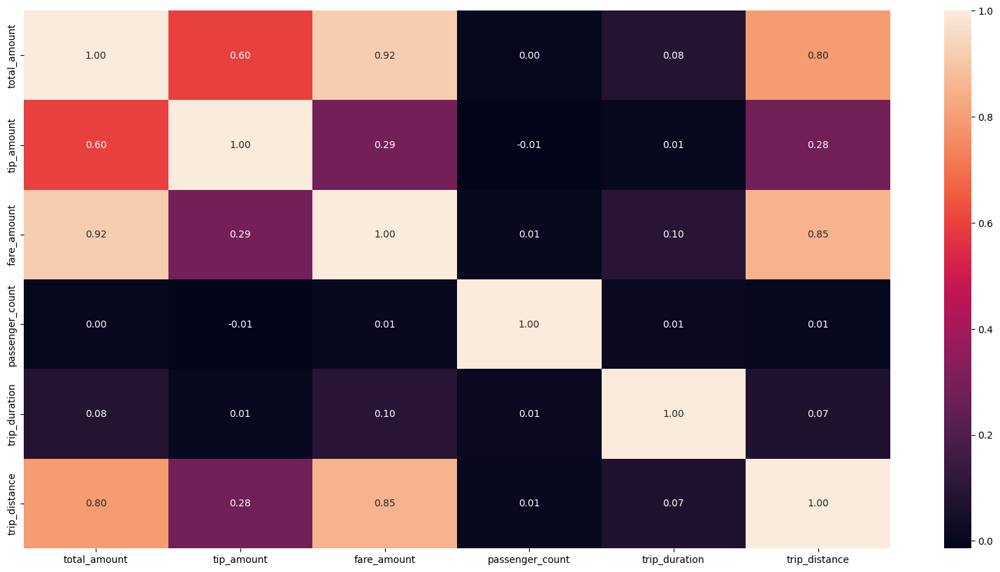

In [13]:
correlation_matrix = clean_data[["total_amount", "tip_amount", "fare_amount", "passenger_count", "trip_duration", "trip_distance"]].corr().compute()
plt.subplots(figsize=(20,10)) 
sns.heatmap(correlation_matrix, annot = True, fmt = ".2f")
plt.show()

In [14]:
trip_class_group =  clean_data.groupby('trip_class').agg(
    {
        'total_amount': ['mean', 'median', 'std'],
        'trip_duration': ['mean', 'median', 'std'],
        'trip_distance': ['mean', 'median', 'std'],
    },
    shuffle='tasks'
)

t1 = trip_class_group["total_amount"].rename(
    columns={
        'mean': 'total_amount_mean', 'median': 'total_amount_median', 'std': 'total_amount_std',
    }
).reset_index()


t2 = trip_class_group["trip_duration"].rename(
    columns={
        'mean': 'trip_duration_mean', 'median': 'trip_duration_median', 'std': 'trip_duration_std',
    }
).reset_index()


t3 = trip_class_group["trip_distance"].rename(
    columns={
        'mean': 'trip_distance_mean', 'median': 'trip_distance_median', 'std': 'trip_distance_std',
    }
).reset_index()

m1 = t1.merge(t2, how="outer", on=["trip_class"])
m2 = m1.merge(t3, how="outer", on=["trip_class"])

final = m2.compute()

In [15]:
final

,trip_class,total_amount_mean,total_amount_median,total_amount_std,trip_duration_mean,trip_duration_median,trip_duration_std,trip_distance_mean,trip_distance_median,trip_distance_std
0,common,12.984239,12.42,3.416921,11.548537,8.283333,58.865116,2.119058,1.947301,1.006556
1,more_common,11.580407,11.30,2.285068,8.602286,6.250000,50.328364,1.721107,1.673714,0.610769
2,less_common,15.539623,15.95,4.297196,15.530151,12.283333,63.754120,3.414168,3.572735,1.390954
3,rare,13.652852,13.80,4.939045,16.160242,12.433333,65.337089,3.696580,4.071630,1.618575


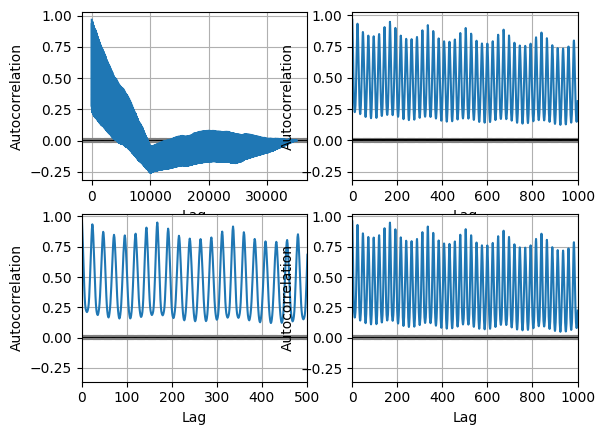

In [19]:
time_s2 = pd.read_csv("time_series_2.csv")
fig, ax = plt.subplots(2,2) 
autocorrelation_plot(time_series_1['count'], ax=ax[0,0])
autocorrelation_plot(time_series_1['sum'], ax=ax[0,1]).set_xlim([0, 1000])
autocorrelation_plot(time_series_2['count'], ax=ax[1,0]).set_xlim([0, 500])
autocorrelation_plot(time_series_2['sum'], ax=ax[1,1]).set_xlim([0, 1000])

fig.show()

C:\Users\ASUS\AppData\Local\Temp\ipykernel_7896\2030580917.py:8: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.



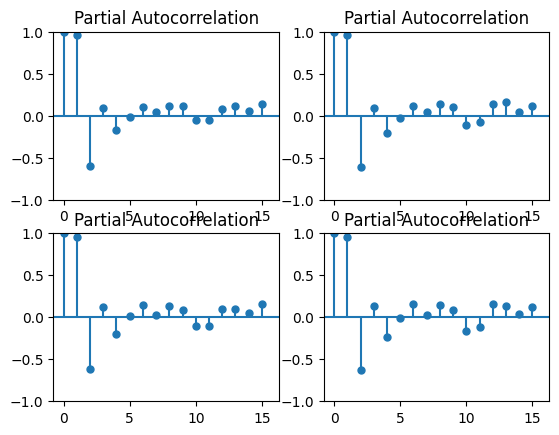

In [88]:
fig, ax = plt.subplots(2,2) 

plot_pacf(time_series_1['count'], lags=15, method='ywm', ax=ax[0,0])
plot_pacf(time_series_1['sum'], lags=15, method='ywm', ax=ax[0,1])
plot_pacf(time_series_2['count'], lags=15, method='ywm', ax=ax[1,0])
plot_pacf(time_series_2['sum'], lags=15, method='ywm', ax=ax[1,1])

fig.show()

In [16]:
stat = time_series_1.set_index('Date')
stat['mean'] = stat['sum'].rolling(window = 70).mean()
stat = stat.reset_index()
fig = px.line(stat, x='Date', y=['mean'])
fig.show()

In [17]:
stat = time_series_2.set_index('Date')
stat['mean'] = stat['sum'].rolling(window = 70).mean()
stat = stat.reset_index()
fig = px.line(stat, x='Date', y=['mean'])
fig.show()

# 3.b

In [2]:
df_sum_first_vendor = pd.read_csv('time_series_1.csv',usecols=['Date', 'sum'])
df_sum_first_vendor.set_index("Date", inplace=True)
df_count_first_vendor = pd.read_csv('time_series_1.csv',usecols=['Date', 'count'])
df_count_first_vendor.set_index("Date", inplace=True)
df_sum_second_vendor = pd.read_csv('time_series_2.csv',usecols=['Date', 'sum'])
df_sum_second_vendor.set_index("Date", inplace=True)
df_count_second_vendor = pd.read_csv('time_series_2.csv',usecols=['Date', 'count'])
df_count_second_vendor.set_index("Date", inplace=True)

In [3]:
result = adfuller(df_sum_first_vendor['sum'])
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])

result = adfuller(df_count_first_vendor['count'])
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])

result = adfuller(df_sum_second_vendor['sum'])
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])

result = adfuller(df_count_second_vendor['count'])
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])

df_sum_first_vendor_diff = df_sum_first_vendor.diff().dropna()

df_count_first_vendor_diff = df_count_first_vendor.diff().dropna()

df_sum_second_vendor_diff = df_sum_second_vendor.diff().dropna()

df_count_second_vendor_diff = df_count_second_vendor.diff().dropna()

ADF Statistic: -6.054297
p-value: 0.000000
ADF Statistic: -5.194351
p-value: 0.000009
ADF Statistic: -6.292302
p-value: 0.000000
ADF Statistic: -5.321741
p-value: 0.000005


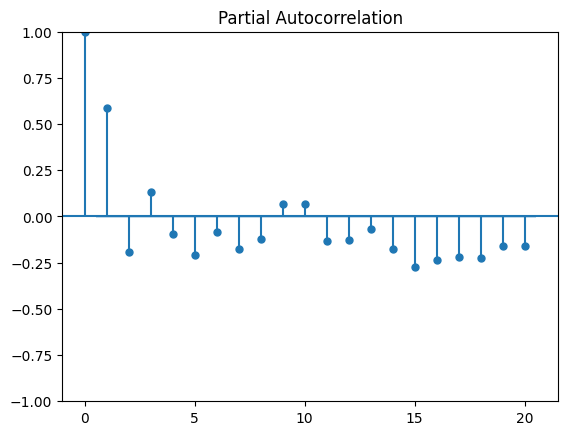

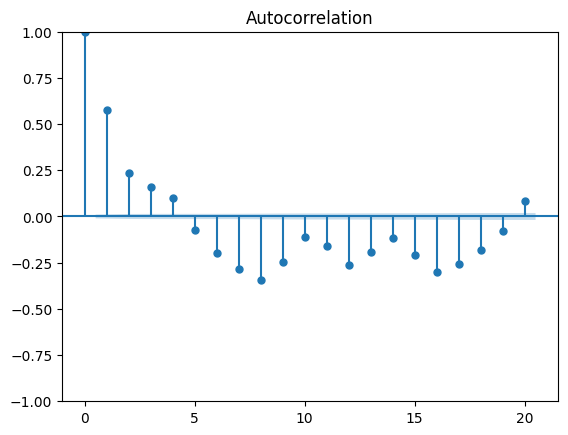

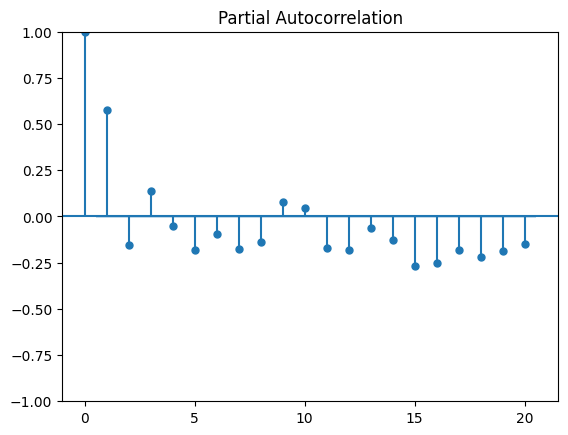

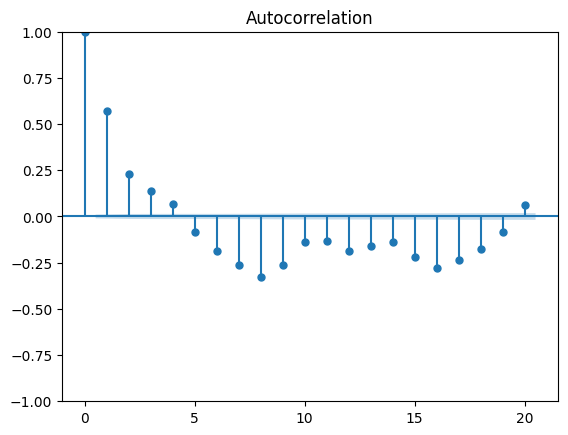

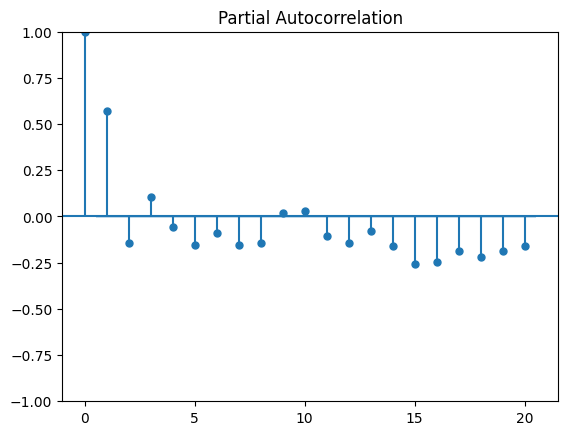

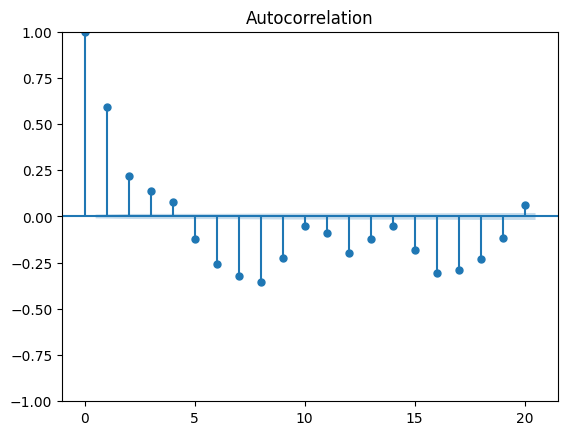

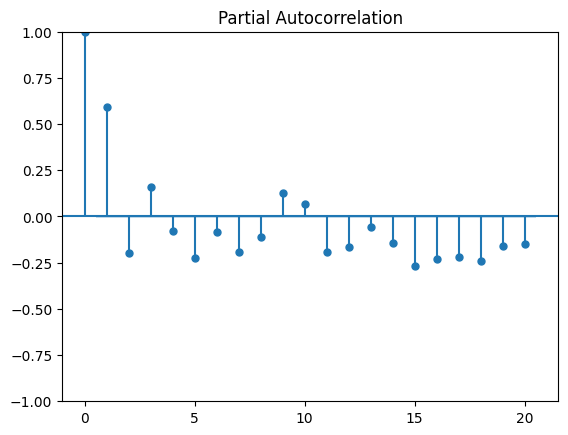

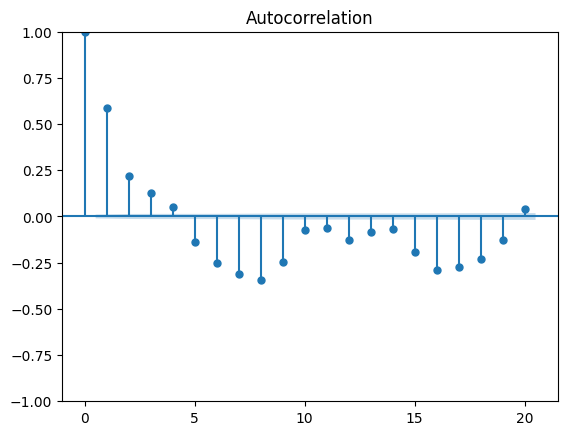

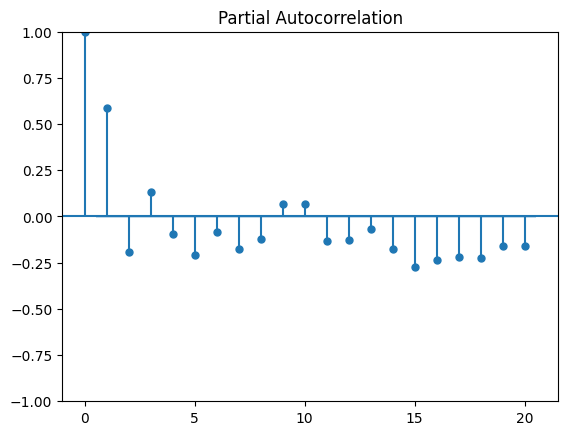

In [5]:
plot_acf(df_sum_first_vendor_diff, lags=20)
plot_pacf(df_sum_first_vendor_diff, lags=20)

plot_acf(df_count_first_vendor_diff, lags=20)
plot_pacf(df_count_first_vendor_diff, lags=20)

plot_acf(df_sum_second_vendor_diff, lags=20)
plot_pacf(df_sum_second_vendor_diff, lags=20)

plot_acf(df_count_second_vendor_diff, lags=20)
plot_pacf(df_count_second_vendor_diff, lags=20)

In [6]:
X_train, X_test = train_test_split(df_sum_first_vendor_diff, test_size=0.2)
X_test = X_test.reset_index()

model_sum_first_vendor = ARIMA(X_train, order=(1, 0, 1))
results_sum_first_vendor = model_sum_first_vendor.fit()
predictions_sum_first_vendor = results_sum_first_vendor.predict(start=0,end=len(X_test)-1,typ='levels')
mse_sum_first_vendor = mean_squared_error(X_test["sum"], predictions_sum_first_vendor)
print("mse_sum_first_vendor: " + str(mse_sum_first_vendor))

mse_sum_first_vendor: 18710705.316211104


In [10]:
X_train, X_test = train_test_split(df_count_first_vendor_diff, test_size=0.2)
X_test = X_test.reset_index()
model_count_first_vendor = ARIMA(X_train, order=(8,1,2))
results_count_first_vendor = model_count_first_vendor.fit()
predictions_count_first_vendor = results_count_first_vendor.predict(start=0,end=len(X_test)-1, typ='levels')
mse_count_first_vendor = mean_squared_error(X_test["count"], predictions_count_first_vendor)
print("mse_count_first_vendor: "+ str(mse_count_first_vendor))

mse_count_first_vendor: 89824.83782341526


In [11]:
X_train, X_test = train_test_split(df_sum_second_vendor_diff, test_size=0.2)
X_test = X_test.reset_index()
model_sum_second_vendor = ARIMA(X_train, order=(1, 0, 1))
results_sum_second_vendor = model_sum_second_vendor.fit()
predictions_sum_second_vendor = results_sum_second_vendor.predict(start=0,end=len(X_test)-1, typ='levels')
mse_sum_second_vendor = mean_squared_error(X_test["sum"], predictions_sum_second_vendor)
print("mse_sum_second_vendor: "+ str(mse_sum_second_vendor))

mse_sum_second_vendor: 75247899.96995679


In [12]:
X_train, X_test = train_test_split(df_count_second_vendor_diff, test_size=0.2, shuffle=False)
X_test = X_test.reset_index()
model_count_second_vendor = ARIMA(X_train, order=(1, 0, 1))
results_count_second_vendor = model_count_second_vendor.fit()
predictions_count_second_vendor = results_count_second_vendor.predict(start=0,end=len(X_test)-1, typ='levels')
mse_count_second_vendor = mean_squared_error(X_test["count"], predictions_count_second_vendor)
print("mse_count_second_vendor: "+ str(mse_count_second_vendor))

mse_count_second_vendor: 518993.93382185424


## tuning ARIMA 

In [14]:
p_values = [0, 3, 2]
d_values = [0, 1]
q_values = [1, 3, 2]

param_combinations = list(itertools.product(p_values, d_values, q_values))
best_score, best_params = float('inf'), None
X_train, X_test = train_test_split(df_sum_first_vendor_diff, test_size=0.2)
X_test = X_test.reset_index()
for params in param_combinations:
    try:
        model_sum_first_vendor = ARIMA(X_train, order=params)
        results_sum_first_vendor = model_sum_first_vendor.fit()
        predictions = results_sum_first_vendor.predict(start=0,end=len(X_test)-1,typ='levels')
        mse_sum_first_vendor = mean_squared_error(X_test["sum"], predictions)
        if mse_sum_first_vendor < best_score:
            best_score, best_params = mse_sum_first_vendor, params
    except:
        continue
print('Best order for sum first vendor:', best_params)


p_values = [0, 3, 2]
d_values = [0, 1]
q_values = [1, 3, 2]

param_combinations = list(itertools.product(p_values, d_values, q_values))
best_score, best_params = float('inf'), None
X_train, X_test = train_test_split(df_count_first_vendor_diff, test_size=0.2)
X_test = X_test.reset_index()
for params in param_combinations:
    try:
        model_count_first_vendor = ARIMA(X_train, order=params)
        results_count_first_vendor = model_count_first_vendor.fit()
        predictions = results_count_first_vendor.predict(start=0,end=len(X_test)-1,typ='levels')
        mse_count_first_vendor = mean_squared_error(X_test["count"], predictions)
        if mse_count_first_vendor < best_score:
            best_score, best_params = mse_count_first_vendor, params
    except:
        continue
print('Best order for count first vendor:', best_params)



p_values = [0, 3, 2]
d_values = [0, 1]
q_values = [1, 3, 2]

param_combinations = list(itertools.product(p_values, d_values, q_values))
best_score, best_params = float('inf'), None
X_train, X_test = train_test_split(df_sum_second_vendor_diff, test_size=0.2)
X_test = X_test.reset_index()
for params in param_combinations:
    try:
        model_sum_second_vendor = ARIMA(X_train, order=params)
        results_sum_second_vendor = model_sum_second_vendor.fit()
        predictions = results_sum_second_vendor.predict(start=0,end=len(X_test)-1,typ='levels')
        mse_sum_second_vendor = mean_squared_error(X_test["sum"], predictions)
        if mse_sum_second_vendor < best_score:
            best_score, best_params = mse_sum_second_vendor, params
    except:
        continue
print('Best order for sum second vendor:', best_params)


p_values = [0, 3, 2]
d_values = [0, 1]
q_values = [1, 3, 2]

param_combinations = list(itertools.product(p_values, d_values, q_values))
best_score, best_params = float('inf'), None
X_train, X_test = train_test_split(df_count_second_vendor_diff, test_size=0.2)
X_test = X_test.reset_index()
for params in param_combinations:
    try:
        model_count_second_vendor = ARIMA(X_train, order=params)
        results_count_second_vendor = model_count_second_vendor.fit()
        predictions = results_count_second_vendor.predict(start=0,end=len(X_test)-1,typ='levels')
        mse_count_second_vendor = mean_squared_error(X_test["count"], predictions)
        if mse_count_second_vendor < best_score:
            best_score, best_params = mse_count_second_vendor, params
    except:
        continue
print('Best order for count second vendor:', best_params)

Best order for sum first vendor: (3, 0, 1)
Best order for count first vendor: (3, 0, 3)
Best order for sum second vendor: (3, 1, 3)
Best order for count second vendor: (3, 0, 2)


## Prophet 

In [58]:
# df_sum_first_vendor_diff = df_sum_first_vendor_diff.reset_index()

# df_sum_first_vendor_diff = df_sum_first_vendor_diff.rename(columns={'Date': 'ds', 'sum': 'y'})

# df_sum_first_vendor_diff.set_index('ds', inplace=True)
X_train, X_test = train_test_split(df_sum_first_vendor_diff, test_size=0.2)
model = Prophet(seasonality_mode='multiplicative', yearly_seasonality=True)
model.fit(X_train)
future_dates = model.make_future_dataframe(periods=len(X_test))
predictions = model.predict(future_dates)
predicted_test = predictions.iloc[-len(X_test):]['yhat']
mse = mean_squared_error(X_test['y'], predicted_test)
print('MSE:', mse)

15:58:19 - cmdstanpy - INFO - Chain [1] start processing
15:58:56 - cmdstanpy - INFO - Chain [1] done processing


MSE: 61758281.98115339


In [79]:
# df_count_first_vendor_diff = df_count_first_vendor_diff.reset_index()
# df_count_first_vendor_diff = df_count_first_vendor_diff.rename(columns={'Date': 'ds', 'count': 'y'})

# df_count_first_vendor_diff.set_index('ds', inplace=True)
# df_count_first_vendor_diff
X_train, X_test = train_test_split(df_count_first_vendor_diff, test_size=0.2)
model = Prophet(seasonality_mode='multiplicative', yearly_seasonality=True)
model.fit(X_train)
future_dates = model.make_future_dataframe(periods=len(X_test))
predictions = model.predict(future_dates)
predicted_test = predictions.iloc[-len(X_test):]['yhat']
mse = mean_squared_error(X_test['y'], predicted_test)
print('MSE:', mse)

16:09:18 - cmdstanpy - INFO - Chain [1] start processing
16:09:47 - cmdstanpy - INFO - Chain [1] done processing


MSE: 272767.2563689745


In [94]:
# df_sum_second_vendor_diff = df_sum_second_vendor_diff.reset_index()
# df_sum_second_vendor_diff = df_sum_second_vendor_diff.rename(columns={'Date': 'ds', 'sum': 'y'})
# df_sum_second_vendor_diff.set_index('ds', inplace=True)
# df_sum_second_vendor_diff
X_train, X_test = train_test_split(df_sum_second_vendor_diff, test_size=0.2)
model = Prophet(seasonality_mode='multiplicative', yearly_seasonality=True)
model.fit(X_train)
future_dates = model.make_future_dataframe(periods=len(X_test))
predictions = model.predict(future_dates)
predicted_test = predictions.iloc[-len(X_test):]['yhat']
mse = mean_squared_error(X_test['y'], predicted_test)
print('MSE:', mse)

16:18:45 - cmdstanpy - INFO - Chain [1] start processing
16:19:14 - cmdstanpy - INFO - Chain [1] done processing


MSE: 543697803.8304437


In [105]:
# df_count_second_vendor_diff = df_count_second_vendor_diff.reset_index()
# df_count_second_vendor_diff = df_count_second_vendor_diff.rename(columns={'count': 'y'})
# df_count_second_vendor_diff.set_index('ds', inplace=True)
# df_count_second_vendor_diff
X_train, X_test = train_test_split(df_count_second_vendor_diff, test_size=0.2)
model = Prophet(seasonality_mode='multiplicative', yearly_seasonality=True)
model.fit(X_train)
future_dates = model.make_future_dataframe(periods=len(X_test))
predictions = model.predict(future_dates)
predicted_test = predictions.iloc[-len(X_test):]['yhat']
mse = mean_squared_error(X_test['y'], predicted_test)
print('MSE:', mse)

16:22:42 - cmdstanpy - INFO - Chain [1] start processing
16:23:25 - cmdstanpy - INFO - Chain [1] done processing


MSE: 1892763.0515611223


## tuning Prophet 

In [44]:
param_grid = {'changepoint_prior_scale': [0.01, 0.1, 1, 10,4]}
X_train, X_test = train_test_split(df_sum_first_vendor_diff, test_size=0.2)
best_score = float('inf')
for params in ParameterGrid(param_grid):
    model_1 = Prophet()
    model_1.changepoint_prior_scale = params['changepoint_prior_scale']
    model_1.fit(X_train)
    forecast = model_1.predict(X_test)
    score = mean_squared_error(X_test['y'], forecast['yhat'])
    if score < best_score:
        best_score = score
        best_params = params
print('Best score:', best_score)
print('Best params:', best_params)
model_1 = Prophet()
model_1.changepoint_prior_scale = best_params['changepoint_prior_scale']
model_1.fit(X_train)
forecast = model_1.predict(X_test)

22:55:30 - cmdstanpy - INFO - Chain [1] start processing
22:55:35 - cmdstanpy - INFO - Chain [1] done processing
22:55:40 - cmdstanpy - INFO - Chain [1] start processing
22:55:46 - cmdstanpy - INFO - Chain [1] done processing
22:55:51 - cmdstanpy - INFO - Chain [1] start processing
22:55:54 - cmdstanpy - INFO - Chain [1] done processing
22:56:00 - cmdstanpy - INFO - Chain [1] start processing
22:56:04 - cmdstanpy - INFO - Chain [1] done processing
22:56:09 - cmdstanpy - INFO - Chain [1] start processing
22:56:12 - cmdstanpy - INFO - Chain [1] done processing


Best score: 24810142.546708092
Best params: {'changepoint_prior_scale': 0.01}


22:56:17 - cmdstanpy - INFO - Chain [1] start processing
22:56:24 - cmdstanpy - INFO - Chain [1] done processing


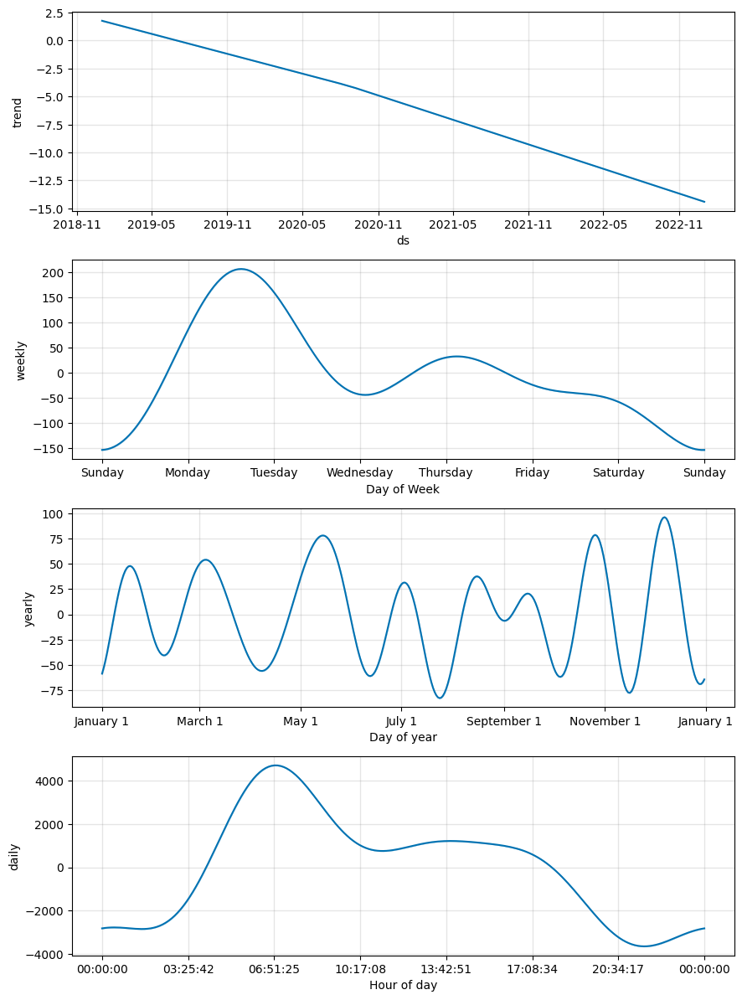

In [45]:
fig = model_1.plot_components(forecast)
plt.show()

In [46]:
# df_count_first_vendor_diff = df_count_first_vendor_diff.reset_index()
# df_count_first_vendor_diff = df_count_first_vendor_diff.rename(columns={'Date': 'ds', 'count': 'y'})
# df_count_first_vendor_diff.set_index('ds', inplace=True)
param_grid = {'changepoint_prior_scale': [0.01, 0.1, 1, 10,4]}
X_train, X_test = train_test_split(df_count_first_vendor_diff, test_size=0.2)
best_score = float('inf')
for params in ParameterGrid(param_grid):
    model_2 = Prophet()
    model_2.changepoint_prior_scale = params['changepoint_prior_scale']
    model_2.fit(X_train)
    forecast = model_2.predict(X_test)
    score = mean_squared_error(X_test['y'], forecast['yhat'])
    if score < best_score:
        best_score = score
        best_params = params
print('Best score:', best_score)
print('Best params:', best_params)
model_2 = Prophet()
model_2.changepoint_prior_scale = best_params['changepoint_prior_scale']
model_2.fit(X_train)
forecast = model_2.predict(X_test)

22:56:31 - cmdstanpy - INFO - Chain [1] start processing
22:56:35 - cmdstanpy - INFO - Chain [1] done processing
22:56:39 - cmdstanpy - INFO - Chain [1] start processing
22:56:43 - cmdstanpy - INFO - Chain [1] done processing
22:56:48 - cmdstanpy - INFO - Chain [1] start processing
22:56:50 - cmdstanpy - INFO - Chain [1] done processing
22:56:55 - cmdstanpy - INFO - Chain [1] start processing
22:56:59 - cmdstanpy - INFO - Chain [1] done processing
22:57:04 - cmdstanpy - INFO - Chain [1] start processing
22:57:08 - cmdstanpy - INFO - Chain [1] done processing


Best score: 121048.91267672568
Best params: {'changepoint_prior_scale': 1}


22:57:12 - cmdstanpy - INFO - Chain [1] start processing
22:57:14 - cmdstanpy - INFO - Chain [1] done processing


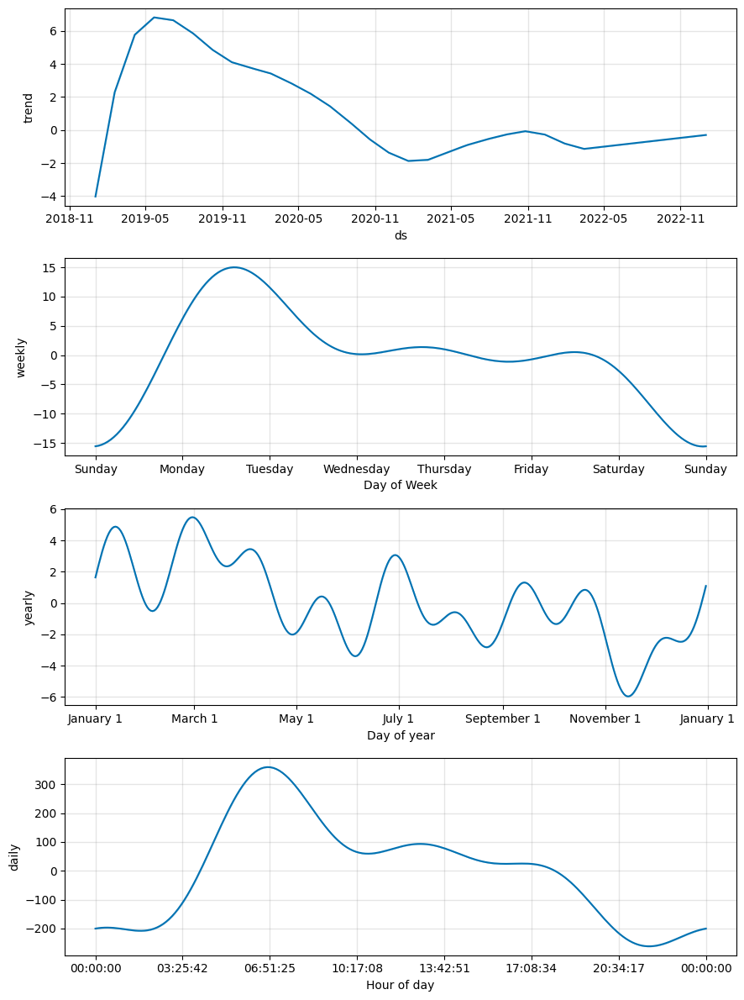

In [47]:
fig = model_2.plot_components(forecast)
plt.show()

In [48]:
# df_sum_second_vendor_diff = df_sum_second_vendor_diff.reset_index()
# df_sum_second_vendor_diff = df_sum_second_vendor_diff.rename(columns={'Date': 'ds', 'sum': 'y'})
# df_sum_second_vendor_diff.set_index('ds', inplace=True)
param_grid = {'changepoint_prior_scale': [0.01, 0.1, 1, 10,4]}
X_train, X_test = train_test_split(df_sum_second_vendor_diff, test_size=0.2)
best_score = float('inf')
for params in ParameterGrid(param_grid):
    model_3 = Prophet()
    model_3.changepoint_prior_scale = params['changepoint_prior_scale']
    model_3.fit(X_train)
    forecast = model_3.predict(X_test)
    score = mean_squared_error(X_test['y'], forecast['yhat'])
    if score < best_score:
        best_score = score
        best_params = params
print('Best score:', best_score)
print('Best params:', best_params)
model_3 = Prophet()
model_3.changepoint_prior_scale = best_params['changepoint_prior_scale']
model_3.fit(X_train)
forecast = model_3.predict(X_test)

22:57:19 - cmdstanpy - INFO - Chain [1] start processing
22:57:22 - cmdstanpy - INFO - Chain [1] done processing
22:57:26 - cmdstanpy - INFO - Chain [1] start processing
22:57:33 - cmdstanpy - INFO - Chain [1] done processing
22:57:37 - cmdstanpy - INFO - Chain [1] start processing
22:57:40 - cmdstanpy - INFO - Chain [1] done processing
22:57:44 - cmdstanpy - INFO - Chain [1] start processing
22:57:48 - cmdstanpy - INFO - Chain [1] done processing
22:57:52 - cmdstanpy - INFO - Chain [1] start processing
22:57:54 - cmdstanpy - INFO - Chain [1] done processing


Best score: 103765915.99508233
Best params: {'changepoint_prior_scale': 0.01}


22:57:58 - cmdstanpy - INFO - Chain [1] start processing
22:58:01 - cmdstanpy - INFO - Chain [1] done processing


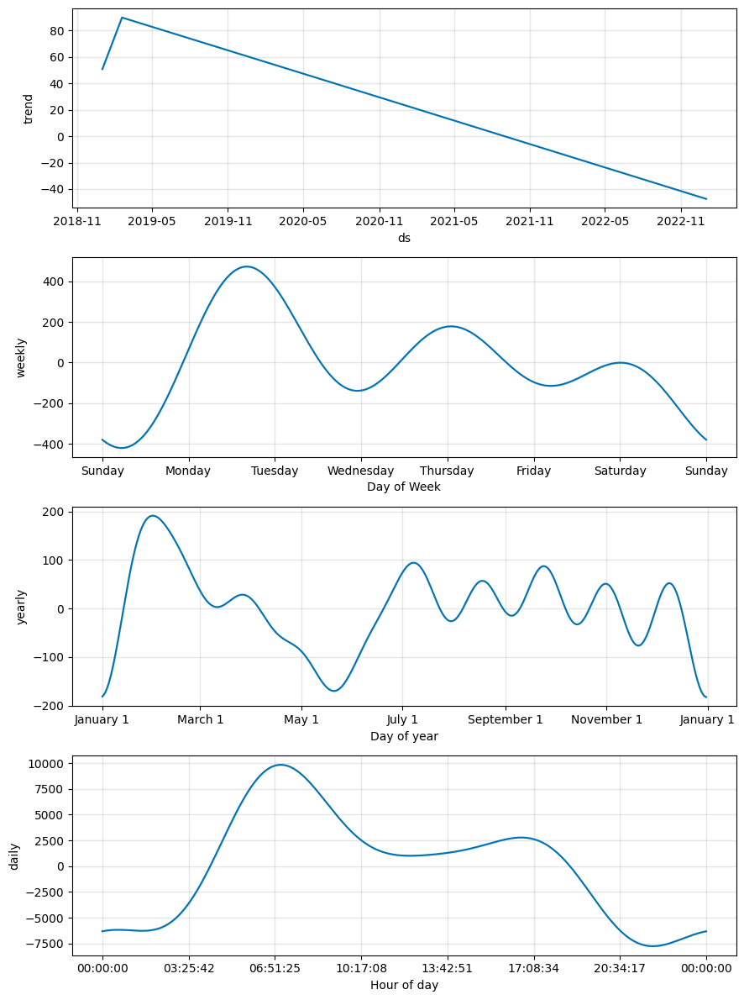

In [49]:
fig = model_3.plot_components(forecast)
plt.show()

In [50]:
# df_count_second_vendor_diff = df_count_second_vendor_diff.reset_index()
# df_count_second_vendor_diff = df_count_second_vendor_diff.rename(columns={'Date': 'ds', 'count': 'y'})
# df_count_second_vendor_diff.set_index('ds', inplace=True)
param_grid = {'changepoint_prior_scale': [0.01, 0.1, 1, 10,4]}
X_train, X_test = train_test_split(df_count_second_vendor_diff, test_size=0.2)
best_score = float('inf')
for params in ParameterGrid(param_grid):
    model_4 = Prophet()
    model_4.changepoint_prior_scale = params['changepoint_prior_scale']
    model_4.fit(X_train)
    forecast = model_4.predict(X_test)
    score = mean_squared_error(X_test['y'], forecast['yhat'])
    if score < best_score:
        best_score = score
        best_params = params
print('Best score:', best_score)
print('Best params:', best_params)
model_4 = Prophet()
model_4.changepoint_prior_scale = best_params['changepoint_prior_scale']
model_4.fit(X_train)
forecast = model_4.predict(X_test)

22:58:07 - cmdstanpy - INFO - Chain [1] start processing
22:58:11 - cmdstanpy - INFO - Chain [1] done processing
22:58:16 - cmdstanpy - INFO - Chain [1] start processing
22:58:22 - cmdstanpy - INFO - Chain [1] done processing
22:58:27 - cmdstanpy - INFO - Chain [1] start processing
22:58:30 - cmdstanpy - INFO - Chain [1] done processing
22:58:34 - cmdstanpy - INFO - Chain [1] start processing
22:58:35 - cmdstanpy - INFO - Chain [1] done processing
22:58:40 - cmdstanpy - INFO - Chain [1] start processing
22:58:41 - cmdstanpy - INFO - Chain [1] done processing


Best score: 521634.0249680778
Best params: {'changepoint_prior_scale': 0.01}


22:58:45 - cmdstanpy - INFO - Chain [1] start processing
22:58:50 - cmdstanpy - INFO - Chain [1] done processing


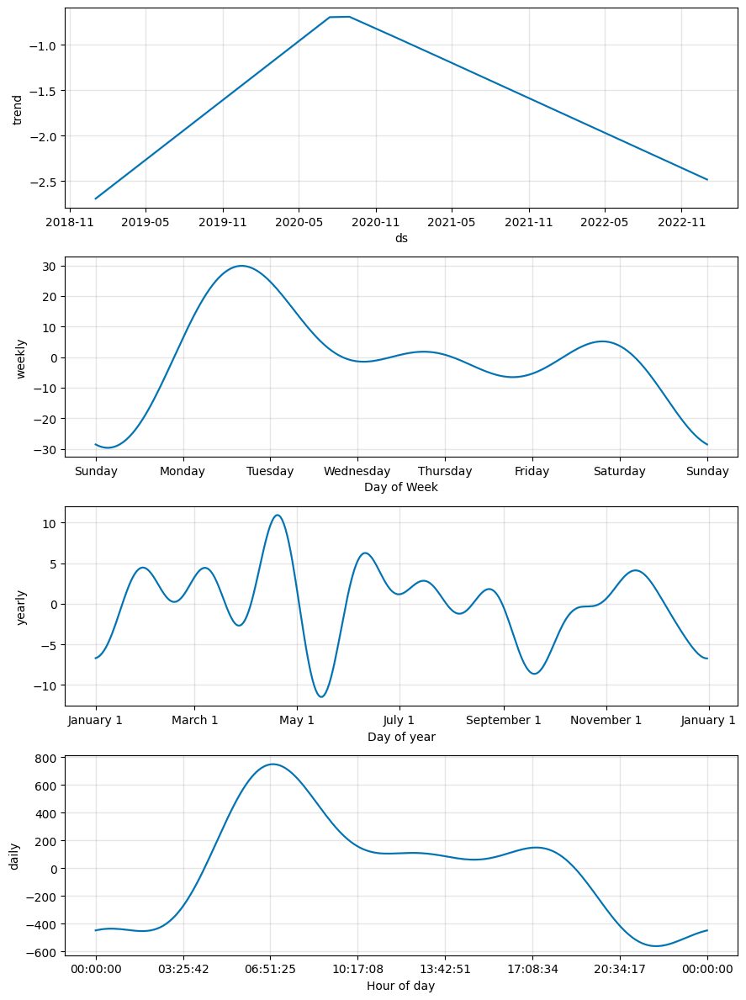

In [51]:
fig = model_4.plot_components(forecast)
plt.show()

In [22]:
import plotly.offline as po
po.init_notebook_mode()